In [1]:
%pip install -q pandas matplotlib seaborn polars tqdm

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import json
import os
import concurrent.futures
from tqdm import tqdm

def load_json(file_path):
    with open(file_path, 'r') as file:
        return json.load(file)

def load_data_from_directory(directory):
    files = [os.path.join(directory, filename) for filename in os.listdir(directory) if filename.endswith('.json')]
    
    with concurrent.futures.ThreadPoolExecutor() as executor:
        data = list(tqdm(executor.map(load_json, files), total=len(files), desc="Loading JSON files"))
        
    return data

data = load_data_from_directory('../data')

data[0]

Loading JSON files: 100%|██████████| 1000/1000 [01:54<00:00,  8.76it/s]


{'info': {'generated_on': '2017-12-03 08:41:42.057563',
  'slice': '558000-558999',
  'version': 'v1'},
 'playlists': [{'name': 'Baile',
   'collaborative': 'false',
   'pid': 558000,
   'modified_at': 1437177600,
   'num_tracks': 13,
   'num_albums': 8,
   'num_followers': 1,
   'tracks': [{'pos': 0,
     'artist_name': 'Shakira',
     'track_uri': 'spotify:track:4Uc6BcPeBKfZUlX6jhumGv',
     'artist_uri': 'spotify:artist:0EmeFodog0BfCgMzAIvKQp',
     'track_name': "Can't Remember to Forget You",
     'album_uri': 'spotify:album:3pIrfgAYjBpTBBKgtrwKgZ',
     'duration_ms': 206866,
     'album_name': 'Shakira. (Deluxe Version)'},
    {'pos': 1,
     'artist_name': 'Pitbull',
     'track_uri': 'spotify:track:0Hf4aIJpsN4Os2f0y0VqWl',
     'artist_uri': 'spotify:artist:0TnOYISbd1XYRBk9myaseg',
     'track_name': 'Feel This Moment',
     'album_uri': 'spotify:album:2F7tejLHzTqFq2XLol9ZGy',
     'duration_ms': 229506,
     'album_name': 'Global Warming: Meltdown (Deluxe Version)'},
    {'po

In [4]:
playlists, tracks_dict = [], {}

for data_item in tqdm(data, desc="Processing data"):
    if not data_item['playlists']:
        continue
    
    for playlist in data_item['playlists']:
        playlists.append([track['track_uri'] for track in playlist['tracks'] if track['track_uri'] not in tracks_dict])
        for track in playlist['tracks']:
            tracks_dict[track['track_uri']] = track
    
playlists[0]

Processing data: 100%|██████████| 1000/1000 [00:30<00:00, 32.29it/s]


['spotify:track:4Uc6BcPeBKfZUlX6jhumGv',
 'spotify:track:0Hf4aIJpsN4Os2f0y0VqWl',
 'spotify:track:2eqDUxbd0JPEhNrJdPlHLs',
 'spotify:track:4LXDHgBC1mbz3uoehYxH9b',
 'spotify:track:4Y7XAxTANhu3lmnLAzhWJW',
 'spotify:track:3ZFTkvIE7kyPt6Nu3PEa7V',
 'spotify:track:1eAj7zEFiX24oYScyIP8aO',
 'spotify:track:3XVCXTxYPptsMLwO463btY',
 'spotify:track:0UGJsRE9T0r6sIMR3mQzUW',
 'spotify:track:6JFBgJECPfDjzVLJ65jqm7',
 'spotify:track:4MK30zdOpWTvpE6UoJukIp',
 'spotify:track:4fIk8LQ1hojY8ZfFQi419y',
 'spotify:track:32lm3769IRfcnrQV11LO4E']

In [7]:
num_playlists = len(playlists)
all_track_uris = [track for pl in playlists for track in pl]
unique_tracks = set(all_track_uris)

print(f"Total playlists: {num_playlists}")
print(f"Total track uses: {len(all_track_uris)}")
print(f"Unique tracks: {len(unique_tracks)}")

Total playlists: 1000000
Total track uses: 2290221
Unique tracks: 2262292


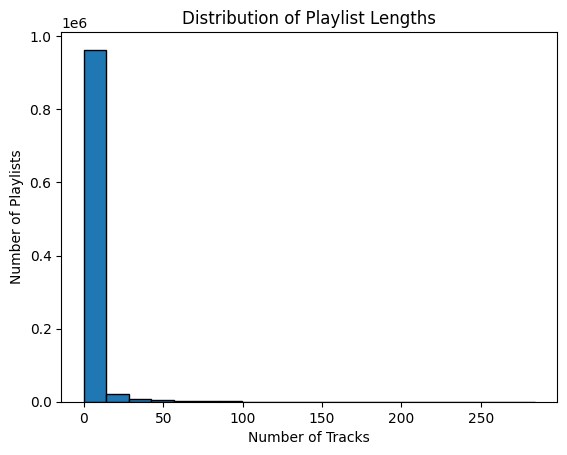

In [8]:
import matplotlib.pyplot as plt

playlist_lengths = [len(pl) for pl in playlists]

plt.hist(playlist_lengths, bins=20, edgecolor='black')
plt.title("Distribution of Playlist Lengths")
plt.xlabel("Number of Tracks")
plt.ylabel("Number of Playlists")
plt.show()

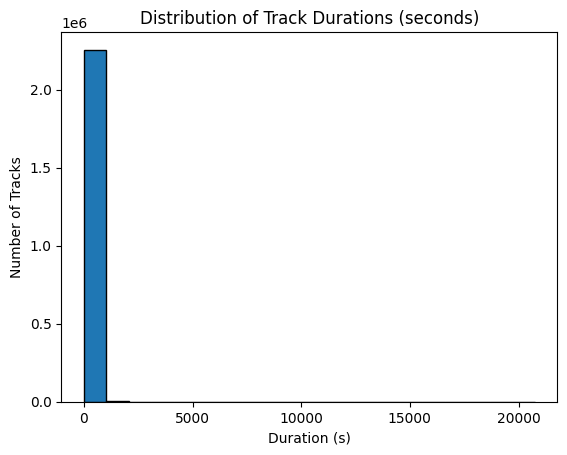

In [9]:
durations = [track['duration_ms'] / 1000 for track in tracks_dict.values() if 'duration_ms' in track]

plt.hist(durations, bins=20, edgecolor='black')
plt.title("Distribution of Track Durations (seconds)")
plt.xlabel("Duration (s)")
plt.ylabel("Number of Tracks")
plt.show()

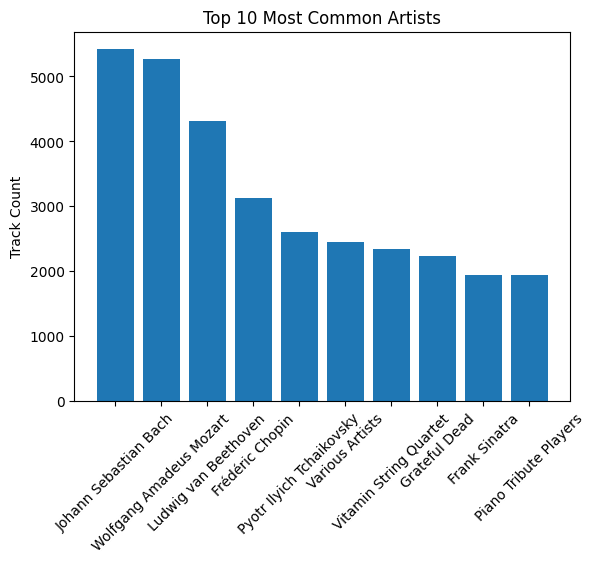

In [10]:
from collections import Counter

artist_counter = Counter(track['artist_name'] for track in tracks_dict.values() if 'artist_name' in track)
top_artists = artist_counter.most_common(10)

# Plotting
labels, counts = zip(*top_artists)
plt.bar(labels, counts)
plt.xticks(rotation=45)
plt.title("Top 10 Most Common Artists")
plt.ylabel("Track Count")
plt.show()


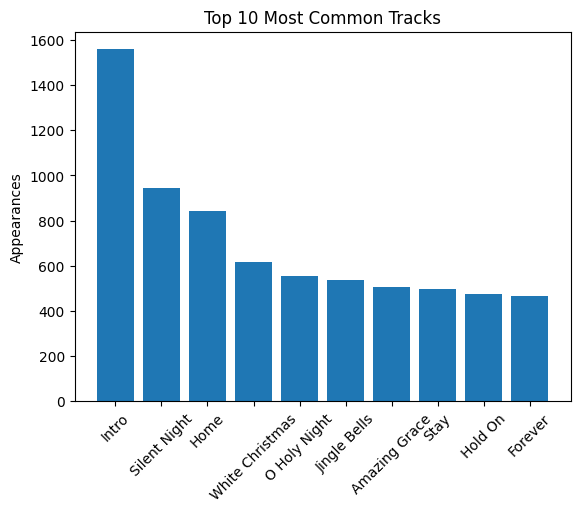

In [11]:
trackname_counter = Counter(track['track_name'] for track in tracks_dict.values() if 'track_name' in track)
top_tracks = trackname_counter.most_common(10)

# Plotting
labels, counts = zip(*top_tracks)
plt.bar(labels, counts)
plt.xticks(rotation=45)
plt.title("Top 10 Most Common Tracks")
plt.ylabel("Appearances")
plt.show()


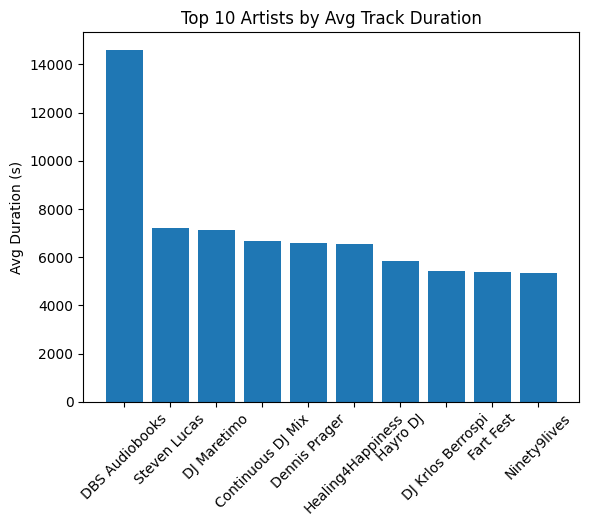

In [12]:
from collections import defaultdict
import statistics

artist_durations = defaultdict(list)

for track in tracks_dict.values():
    if 'artist_name' in track and 'duration_ms' in track:
        artist_durations[track['artist_name']].append(track['duration_ms'] / 1000)

# Compute average and take top 10
artist_avg = {artist: statistics.mean(durations) for artist, durations in artist_durations.items() if len(durations) > 1}
top_avg_artists = sorted(artist_avg.items(), key=lambda x: x[1], reverse=True)[:10]

# Plot
labels, durations = zip(*top_avg_artists)
plt.bar(labels, durations)
plt.xticks(rotation=45)
plt.ylabel("Avg Duration (s)")
plt.title("Top 10 Artists by Avg Track Duration")
plt.show()


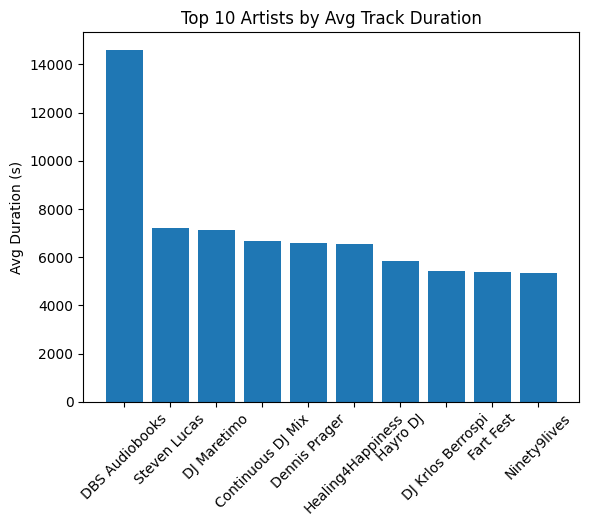

In [13]:
from collections import defaultdict
import statistics

artist_durations = defaultdict(list)

for track in tracks_dict.values():
    if 'artist_name' in track and 'duration_ms' in track:
        artist_durations[track['artist_name']].append(track['duration_ms'] / 1000)

# Compute average and take top 10
artist_avg = {artist: statistics.mean(durations) for artist, durations in artist_durations.items() if len(durations) > 1}
top_avg_artists = sorted(artist_avg.items(), key=lambda x: x[1], reverse=True)[:10]

# Plot
labels, durations = zip(*top_avg_artists)
plt.bar(labels, durations)
plt.xticks(rotation=45)
plt.ylabel("Avg Duration (s)")
plt.title("Top 10 Artists by Avg Track Duration")
plt.show()


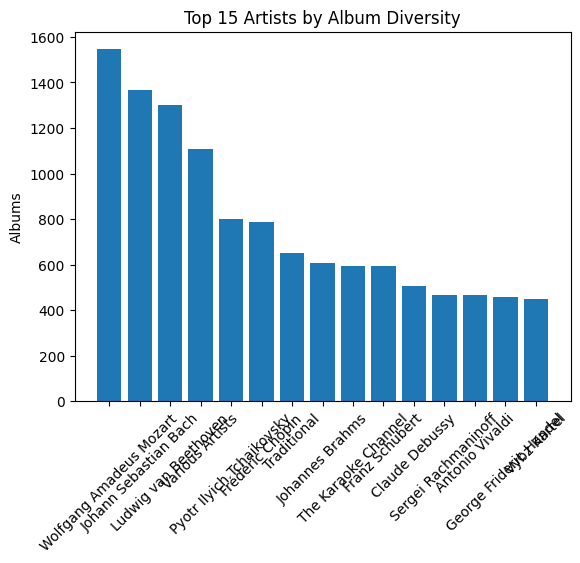

In [14]:
from collections import defaultdict

artist_albums = defaultdict(set)
for t in tracks_dict.values():
    artist_albums[t['artist_name']].add(t['album_uri'])

diverse_artists = sorted(artist_albums.items(), key=lambda x: len(x[1]), reverse=True)[:15]
labels, counts = zip(*[(k, len(v)) for k, v in diverse_artists])
plt.bar(labels, counts)
plt.xticks(rotation=45)
plt.title("Top 15 Artists by Album Diversity")
plt.ylabel("Albums")
plt.show()

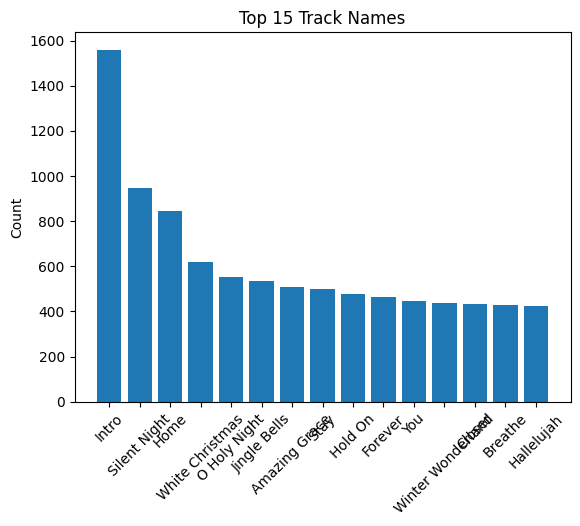

In [15]:
track_counts = Counter(t['track_name'] for t in tracks_dict.values())
top_tracks = track_counts.most_common(15)

labels, counts = zip(*top_tracks)
plt.bar(labels, counts)
plt.xticks(rotation=45)
plt.title("Top 15 Track Names")
plt.ylabel("Count")
plt.show()


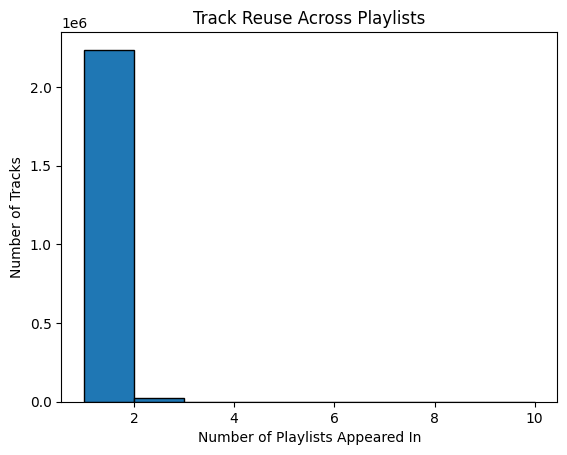

In [16]:
from collections import defaultdict

track_use_count = defaultdict(int)
for pl in playlists:
    for track_uri in pl:
        track_use_count[track_uri] += 1

reuse_distribution = list(track_use_count.values())

plt.hist(reuse_distribution, bins=range(1, 11), edgecolor='black')
plt.title("Track Reuse Across Playlists")
plt.xlabel("Number of Playlists Appeared In")
plt.ylabel("Number of Tracks")
plt.show()


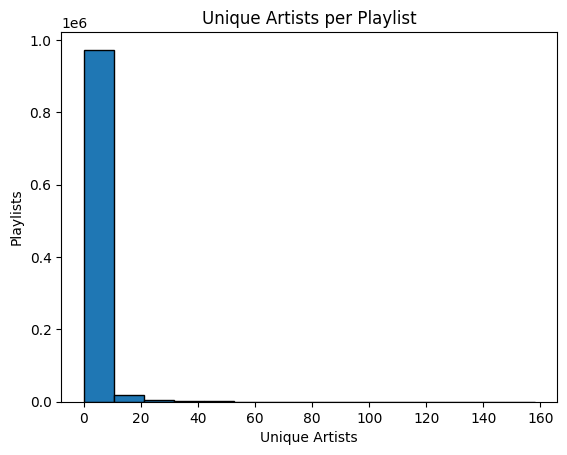

In [17]:
unique_artists_per_playlist = []

for pl in playlists:
    artist_set = {tracks_dict[tid]['artist_name'] for tid in pl if tid in tracks_dict}
    unique_artists_per_playlist.append(len(artist_set))

plt.hist(unique_artists_per_playlist, bins=15, edgecolor='black')
plt.title("Unique Artists per Playlist")
plt.xlabel("Unique Artists")
plt.ylabel("Playlists")
plt.show()


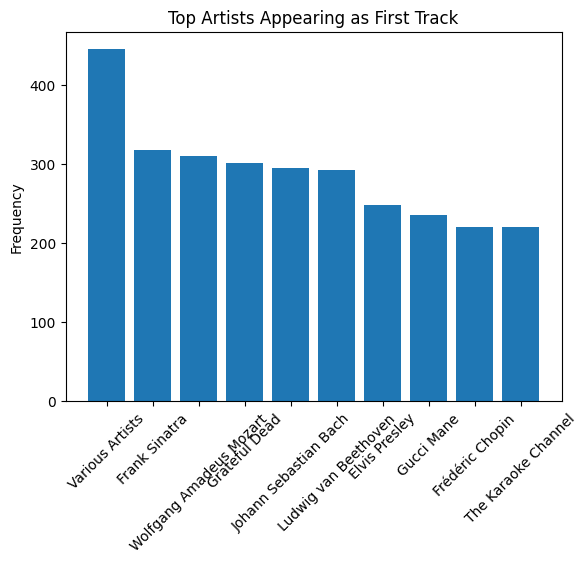

In [18]:
from collections import Counter

first_track_artists = [
    tracks_dict[pl[0]]['artist_name']
    for pl in playlists
    if pl and pl[0] in tracks_dict
]

top_first_artists = Counter(first_track_artists).most_common(10)
labels, counts = zip(*top_first_artists)

plt.bar(labels, counts)
plt.xticks(rotation=45)
plt.title("Top Artists Appearing as First Track")
plt.ylabel("Frequency")
plt.show()


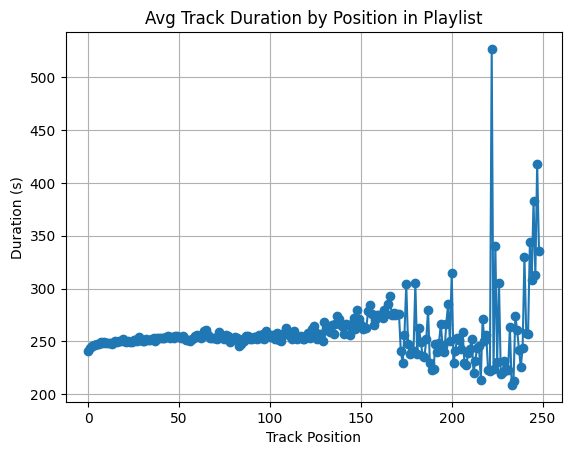

In [19]:
from collections import defaultdict

position_durations = defaultdict(list)

for pl in playlists:
    for i, tid in enumerate(pl):
        if tid in tracks_dict:
            duration = tracks_dict[tid]['duration_ms'] / 1000
            position_durations[i].append(duration)

avg_duration_by_pos = {
    pos: statistics.mean(durs)
    for pos, durs in position_durations.items()
    if len(durs) > 1
}

# Plot
positions, avg_durations = zip(*sorted(avg_duration_by_pos.items()))
plt.plot(positions, avg_durations, marker='o')
plt.title("Avg Track Duration by Position in Playlist")
plt.xlabel("Track Position")
plt.ylabel("Duration (s)")
plt.grid(True)
plt.show()


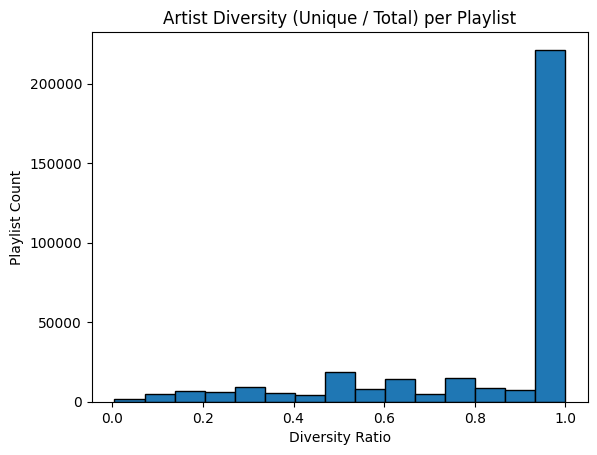

In [21]:
artist_diversity_ratios = []

for pl in playlists:
    artists = [tracks_dict[tid]['artist_name'] for tid in pl if tid in tracks_dict]
    if artists:
        unique = len(set(artists))
        diversity = unique / len(artists)
        artist_diversity_ratios.append(diversity)

plt.hist(artist_diversity_ratios, bins=15, edgecolor='black')
plt.title("Artist Diversity (Unique / Total) per Playlist")
plt.xlabel("Diversity Ratio")
plt.ylabel("Playlist Count")
plt.show()


In [22]:
from itertools import combinations

pair_counter = Counter()

for pl in playlists:
    unique_tracks = list(set(pl))
    if len(unique_tracks) < 2:
        continue
    for t1, t2 in combinations(sorted(unique_tracks), 2):
        pair_counter[(t1, t2)] += 1

# Most common co-occurring pairs
top_pairs = [(pair, count) for pair, count in pair_counter.items() if count > 5]
top_pairs = sorted(top_pairs, key=lambda x: x[1], reverse=True)[:10]

# Display results
for (t1, t2), count in top_pairs:
    print(f"{tracks_dict[t1]['track_name']} + {tracks_dict[t2]['track_name']} → {count} playlists")
